# This is the notebook for the diabetes dataset.

In [74]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import accuracy_score,  confusion_matrix, classification_report
from pandas.plotting import scatter_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression

In [34]:
#Let's read our data and take a look
diabetes_data = pd.read_csv('../datasets/diabetes.csv')
diabetes_data

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [35]:
#Show me only the columns where there are null values
diabetes_data.isna().sum()[diabetes_data.isna().sum() > 0]
#Seems we do not have any null values, nice.

Series([], dtype: int64)

### I will draw a Scatter Matrix to see if there are any outliers in the data.

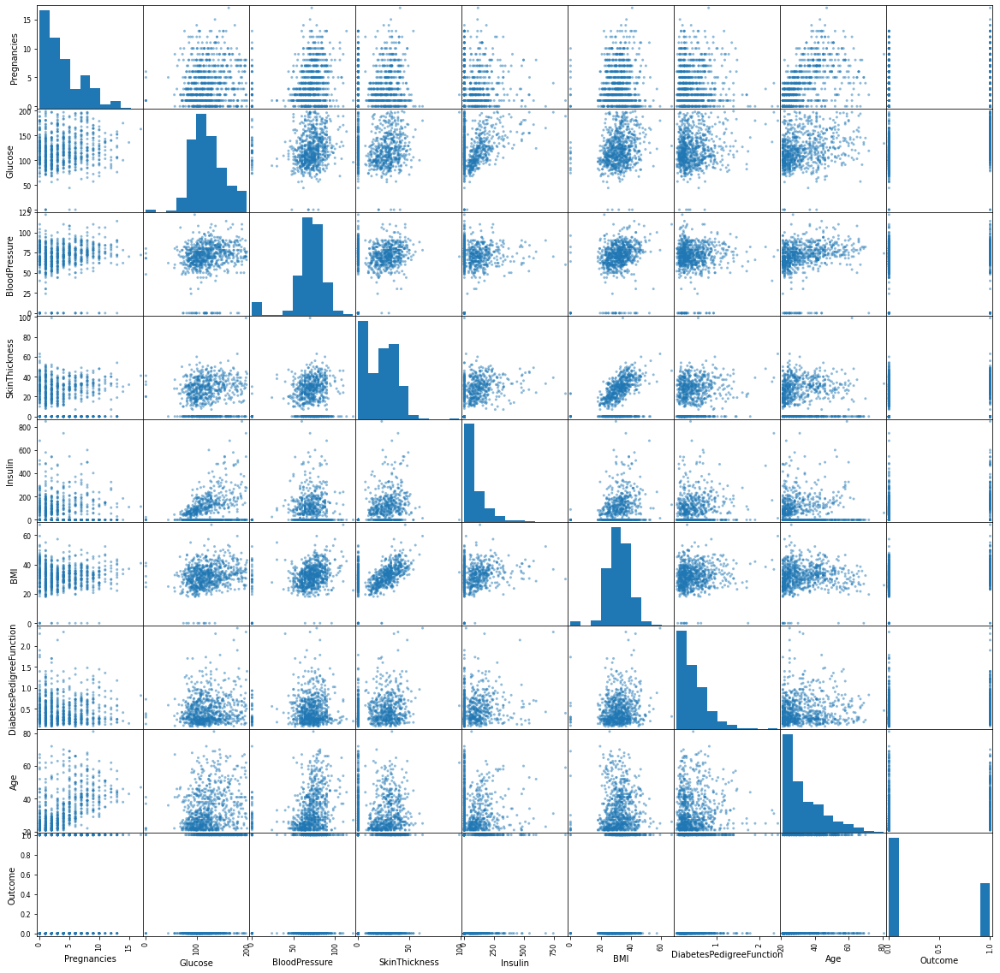

In [36]:
scatter_matrix(diabetes_data, figsize=(20,20))
print()

### We can observe some things:
- There are many 0 values in `SkinThickness`, I will replace those with a median.
- Some rows seem to have a 0 `BMI` column too, which I will use median to fix too.
- The `BloodPressure` seems to be 0 for some rows, I will use the median.
- We also have a lot of similar values in the `Insulin` column, I will leave those alone because I am not sure that it is an error.

In [43]:
#Replacing the 0 values with the median for that column.
diabetes_data['SkinThickness'] = diabetes_data['SkinThickness'].apply(lambda x: x if not x == 0 else diabetes_data['SkinThickness'].median())

#Replacing the 0 values with the median for that column.
diabetes_data['BMI'] = diabetes_data['BMI'].apply(lambda x: x if not x == 0 else diabetes_data['BMI'].median())

#Replacing the 0 values with the median for that column.
diabetes_data['BloodPressure'] = diabetes_data['BloodPressure'].apply(lambda x: x if not x == 0 else diabetes_data['BloodPressure'].median())

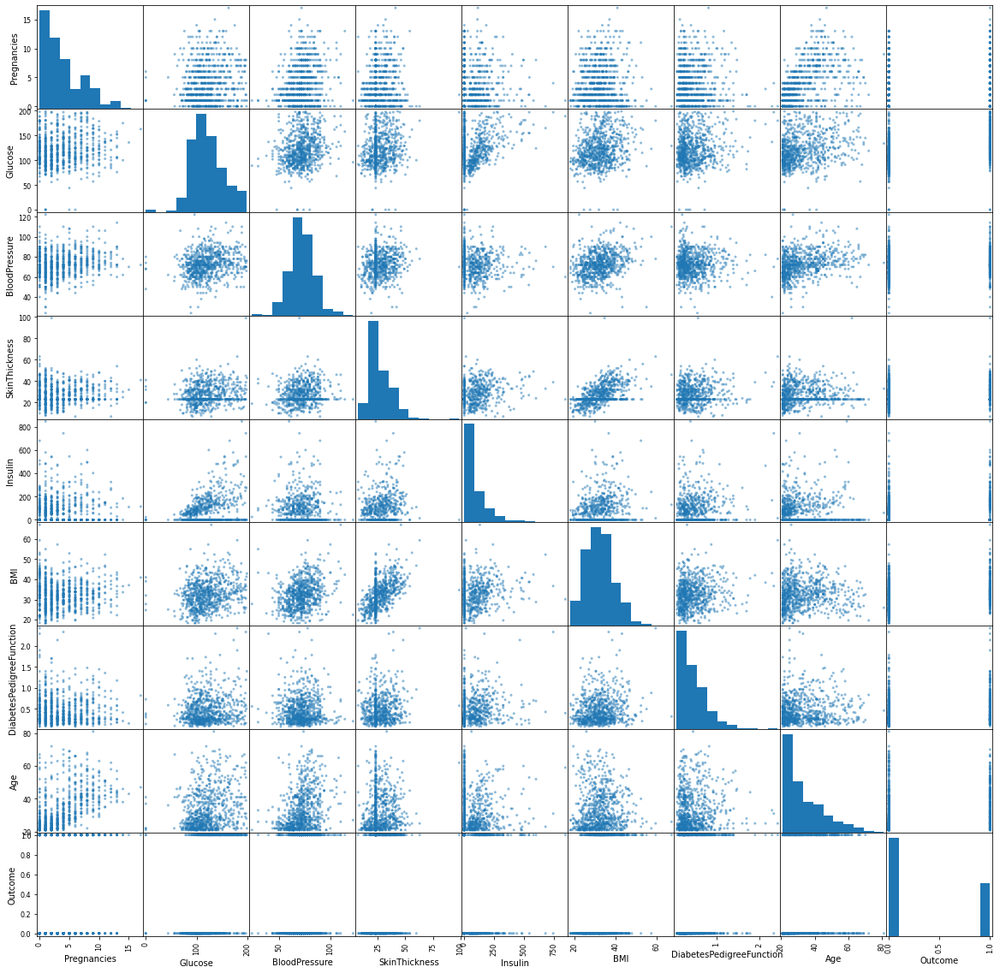

In [42]:
scatter_matrix(diabetes_data, figsize=(20,20))
print()

### Our data looks a little bit better now, I do not see anything too out of the ordinary in the histograms and I believe we are ready to fit a model.

### I am going to fit a Random Forest Ensemble Classifier to this dataset for a few reasons:
- I believe some datafields might be ignored because the outcome counts are very close.
- A decision tree would be helpful because a human can review the conditions when coming to a diagnosis.

### I will use GridSearch with cross-validation so a manual train/test split will not be necessary. I will just create an X and a y.

In [46]:
#Input variables
X = diabetes_data.drop(['Outcome'], axis=1)
#Output variable
y = diabetes_data['Outcome']

### GridSearchCV

In [64]:
#Parameters to test
params = {'n_estimators': [10, 15, 20, 30, 35],
          'criterion': ['gini', 'entropy'],
          'max_depth': [None, 1, 2, 3, 4, 5, 10, 15, 100, 150, 500, 1000]}

#Our instance of random forest classifier
rfc = RandomForestClassifier(random_state=42)

#GridSearchCV to try combinations of parameters
clf = GridSearchCV(rfc, params, cv=5)

#Enter the void...
clf.fit(X, y)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 1, 2, 3, 4, 5, 10, 15, 100, 150,
                                       500, 1000],
                         'n_estimators': [10, 15, 20, 30, 35]})

In [65]:
#This is the best accuracy that we were able to get with the Random Forest Classifier
clf.best_score_

0.7709192768016297

In [66]:
#And here are the best parameters
clf.best_params_

{'criterion': 'gini', 'max_depth': 5, 'n_estimators': 35}

### Let's pretend we did not get this miserable result and fit KNN to this data.

In [68]:
#Parameters for GridSearchCV
params = {'n_neighbors': [x for x in range(1, 50)],
          'metric': ['euclidean', 'manhattan', 'minkowski', 'chebyshev', 'wminkowski', 'seuclidean', 'mahalanobis']}

#Our instance of KNN
knn = KNeighborsClassifier()

#GridSearchCV to try combinations of parameters
clf2 = GridSearchCV(knn, params, cv=5)

#Fitting to the data
clf2.fit(X, y)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'metric': ['euclidean', 'manhattan', 'minkowski',
                                    'chebyshev', 'wminkowski', 'seuclidean',
                                    'mahalanobis'],
                         'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                         13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
                                         23, 24, 25, 26, 27, 28, 29, 30, ...]})

In [69]:
#We are still getting a pretty miserable score...
clf2.best_score_

0.7591800356506239

### Let's try Logistic Regression

In [75]:
#Parameters for GridSearchCV
params = {'penalty': ['l1', 'l2', 'elasticnet', 'none'],
          'tol': [1e-4, 1e-3],
          'C': [1.0, 1.05, 1.1, 1.2, 1.5]}

#Our instance of KNN
lr = LogisticRegression()

#GridSearchCV to try combinations of parameters
clf4 = GridSearchCV(lr, params, cv=5)

#Fitting to the data
clf4.fit(X, y)

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid={'C': [1.0, 1.05, 1.1, 1.2, 1.5],
                         'penalty': ['l1', 'l2', 'elasticnet', 'none'],
                         'tol': [0.0001, 0.001]})

In [76]:
#I think we are not supposed to get a very high accuracy with this dataset...
clf4.best_score_

0.7669382904677022

In [77]:
clf4.best_params_

{'C': 1.1, 'penalty': 'l2', 'tol': 0.0001}

### I will keep my Random Forest example and use that to make a confusion matrix.

In [79]:
#Let's do a train test split
train_X, test_X, train_y, test_y = train_test_split(X, y, train_size=0.75, random_state=42, shuffle=True)

In [80]:
#Here's our classifier with the parameters picked earlier by GridSearchCV
forest_clf = RandomForestClassifier(criterion='gini', max_depth=5, n_estimators=35)

#Let's fit to our training data
forest_clf.fit(train_X, train_y)

RandomForestClassifier(max_depth=5, n_estimators=35)

In [81]:
#Let's get our predictions
predictions = forest_clf.predict(test_X)

In [82]:
#Here's the accuracy score
accuracy_score(test_y, predictions)

0.7395833333333334

In [88]:
#Here's the confusion matrix
m = confusion_matrix(test_y, predictions, labels=[1, 0])
m

array([[44, 25],
       [25, 98]])

In [91]:

print("A true positive being a patient who has diabetes and is classified as having diabetes:\n")
print("Number of true positives:", m[0][0])
print("Number of false positives:", m[0][1])
print("Number of false negatives:", m[1][0])
print("Number of true negatives:", m[1][0])




A true positive being a patient who has diabetes and is classified as having diabetes:

Number of true positives: 44
Number of false positives: 25
Number of false negatives: 25
Number of true negatives: 25


In [93]:
print(classification_report(test_y, predictions))

              precision    recall  f1-score   support

           0       0.80      0.80      0.80       123
           1       0.64      0.64      0.64        69

    accuracy                           0.74       192
   macro avg       0.72      0.72      0.72       192
weighted avg       0.74      0.74      0.74       192



### Some insights:
- The precision for detecting diabetes with this model is significantly lower than predicting absence of diabets. (80% vs 64%)
- This model's predictions should be taken with a grain of salt.
- We can be more confident about a non-diabetes decision.